## Install Dependencies (Only on Google Colab)

In [1]:
!pip install -q gymnasium stable_baselines3
!git clone https://gitlab.unimelb.edu.au/ai4r/ai4r-gym.git
%cd ai4r-gym

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 182.3/182.3 kB 4.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 953.9/953.9 kB 15.2 MB/s eta 0:00:00
Cloning into 'ai4r-gym'...
remote: Enumerating objects: 194, done.
remote: Counting objects: 100% (130/130), done.
remote: Compressing objects: 100% (115/115), done.
remote: Total 194 (delta 64), reused 27 (delta 10), pack-reused 64 (from 1)
Receiving objects: 100% (194/194), 160.29 KiB | 293.00 KiB/s, done.
Resolving deltas: 100% (87/87), done.
/content/ai4r-gym


## Library Imports:

In [2]:
import ai4rgym
from ai4rgym.envs.road import Road
import gymnasium as gym
import numpy as np
import random
from stable_baselines3 import PPO, SAC, DDPG
from utils import ensure_dir, ensure_dirs, eval_model
import matplotlib.pyplot as plt

## Environment Settings:

In [3]:
# SPECIFY THE VEHCILE PARAMETERS
bicycle_model_parameters = {
    "Lf" : 0.55*2.875,
    "Lr" : 0.45*2.875,
    "m"  : 2000.0,
    "Iz" : (1.0/12.0) * 2000.0 * (4.692**2+1.850**2),
    "Cm" : (1.0/100.0) * (1.0 * 400.0 * 9.0) / 0.2286,
    "Cd" : 0.5 * 0.24 * 2.2204 * 1.202,
    "delta_offset" : 0 * np.pi/180,
    "delta_request_max" : 45 * np.pi/180,
    "Ddelta_lower_limit" : -45 * np.pi/180,
    "Ddelta_upper_limit" :  45 * np.pi/180,
    "v_transition_min": 3.0,    # v_transition_min = 3.0 m/s
    "v_transition_max": 5.0,    # v_transition_max = 5.0 m/s
    "body_len_f" : (0.55*2.875) * 1.5,
    "body_len_r" : (0.45*2.875) * 1.5,
    "body_width" : 2.50,
}

# SPECIFY THE ROAD

# This road will not be used for training / evaluation
# this is just kept in place to initialize the environment
road_elements_list = [
    {"type":"straight", "length":100.0},
    {"type":"curved", "curvature":1/800.0, "angle_in_degrees":15.0},
    {"type":"straight", "length":100.0},
    {"type":"curved", "curvature":-1/400.0, "angle_in_degrees":30.0},
    {"type":"straight", "length":100.0},
]

# SPECIFY THE NUMERICAL INTEGRATION DETAILS
numerical_integration_parameters = {
    "method" : "rk4",
    "Ts" : 0.05,
    "num_steps_per_Ts" : 1,
}

# SPECIFY THE INITIAL STATE DISTRIBUTION

py_init_min = -1.0
py_init_max =  1.0

v_init_min_in_kmh = 55.0
v_init_max_in_kmh = 65.0

py_init_min = -1.0
py_init_max =  1.0

v_init_min_in_kmh = 55.0
v_init_max_in_kmh = 65.0

initial_state_bounds = {
    "px_init_min" : 0.0,
    "px_init_max" : 0.0,
    "py_init_min" : py_init_min,
    "py_init_max" : py_init_max,
    "theta_init_min" : 0.0,
    "theta_init_max" : 0.0,
    "vx_init_min" : v_init_min_in_kmh * (1.0/3.6),
    "vx_init_max" : v_init_max_in_kmh * (1.0/3.6),
    "vy_init_min" : 0.0,
    "vy_init_max" : 0.0,
    "omega_init_min" : 0.0,
    "omega_init_max" : 0.0,
    "delta_init_min" : 0.0,
    "delta_init_max" : 0.0,
}

# SPECIFY THE TERMINATION PARAMETERS
termination_parameters = {
    "speed_lower_bound"  :  0.0,
    "speed_upper_bound"  :  (200.0/3.6),
    "distance_to_closest_point_upper_bound"  :  20.0,
    "reward_speed_lower_bound"  :  0.0,
    "reward_speed_upper_bound"  :  0.0,
    "reward_distance_to_closest_point_upper_bound"  :  0.0,
}

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


## Setting Observations:

In [4]:
# SPECIFY THE OBSERVATION PARAMETERS
observation_parameters = {
    "should_include_ground_truth_px"                       :  "info",
    "should_include_ground_truth_py"                       :  "info",
    "should_include_ground_truth_theta"                    :  "info",
    "should_include_ground_truth_vx"                       :  "info",
    "should_include_ground_truth_vy"                       :  "info",
    "should_include_ground_truth_omega"                    :  "info",
    "should_include_ground_truth_delta"                    :  "info",
    "should_include_road_progress_at_closest_point"        :  "info",
    "should_include_vx_sensor"                             :  "obs",
    "should_include_distance_to_closest_point"             :  "obs",
    "should_include_heading_angle_relative_to_line"        :  "obs",
    "should_include_heading_angular_rate_gyro"             :  "info",
    "should_include_closest_point_coords_in_body_frame"    :  "info",
    "should_include_look_ahead_line_coords_in_body_frame"  :  "info",
    "should_include_road_curvature_at_closest_point"       :  "obs",
    "should_include_look_ahead_road_curvatures"            :  "info",

    "scaling_for_ground_truth_px"                       :  1.0,
    "scaling_for_ground_truth_py"                       :  1.0,
    "scaling_for_ground_truth_theta"                    :  1.0,
    "scaling_for_ground_truth_vx"                       :  1.0,
    "scaling_for_ground_truth_vy"                       :  1.0,
    "scaling_for_ground_truth_omega"                    :  1.0,
    "scaling_for_ground_truth_delta"                    :  1.0,
    "scaling_for_road_progress_at_closest_point"        :  1.0,
    "scaling_for_vx_sensor"                             :  1.0,
    "scaling_for_distance_to_closest_point"             :  1.0,
    "scaling_for_heading_angle_relative_to_line"        :  1.0,
    "scaling_for_heading_angular_rate_gyro"             :  1.0,
    "scaling_for_closest_point_coords_in_body_frame"    :  1.0,
    "scaling_for_look_ahead_line_coords_in_body_frame"  :  1.0,
    "scaling_for_road_curvature_at_closest_point"       :  1.0,
    "scaling_for_look_ahead_road_curvatures"            :  1.0,

    "vx_sensor_bias"    : 0.0,
    "vx_sensor_stddev"  : 0.1,

    "distance_to_closest_point_bias"    :  0.0,
    "distance_to_closest_point_stddev"  :  0.01,

    "heading_angle_relative_to_line_bias"    :  0.0,
    "heading_angle_relative_to_line_stddev"  :  0.01,

    "heading_angular_rate_gyro_bias"    :  0.0,
    "heading_angular_rate_gyro_stddev"  :  0.01,

    "closest_point_coords_in_body_frame_bias"    :  0.0,
    "closest_point_coords_in_body_frame_stddev"  :  0.0,

    "look_ahead_line_coords_in_body_frame_bias"    :  0.0,
    "look_ahead_line_coords_in_body_frame_stddev"  :  0.0,

    "road_curvature_at_closest_point_bias"    :  0.0,
    "road_curvature_at_closest_point_stddev"  :  0.0,

    "look_ahead_road_curvatures_bias"    :  0.0,
    "look_ahead_road_curvatures_stddev"  :  0.0,

    "look_ahead_line_coords_in_body_frame_distance"    :  100.0,
    "look_ahead_line_coords_in_body_frame_num_points"  :  10,
}

## Environment Creation:

In [ ]:
SPEED_LIMIT_KMH = 80.0
SPEED_LIMIT =  SPEED_LIMIT_KMH  / 3.6  # 60 km/h converted to m/s

path_for_saving_figures = f"models/compare/eval"
ensure_dir(path_for_saving_figures)

In [5]:
# class RewardWrapper(gym.Wrapper):
#     def __init__(self, env):
#         super(RewardWrapper, self).__init__(env)
#         self.prev_vx = None
#         self.prev_delta = None

    # def step(self, action):
    #     observation, reward, terminated, truncated, info = self.env.step(action)


    #     distance_to_center = abs(observation["distance_to_closest_point"])
    #     heading_error = abs(observation["heading_angle_relative_to_line"])
    #     vx = observation["vx_sensor"]
    #     road_curvature = observation["road_curvature_at_closest_point"]

    #     curvature_threshold = 1 / 150.0

    #     if abs(road_curvature) >= curvature_threshold:
    #         max_speed_in_high_curvature = 30.0
    #         speed_reward = - (vx / max_speed_in_high_curvature)
    #     else:
    #         desired_speed = 60.0
    #         speed_tolerance = 5.0
    #         speed_reward = np.exp(- ((vx - desired_speed) ** 2) / (2 * speed_tolerance ** 2))

    #         speed_reward = speed_reward * 2.0
    #     reward = reward
    #     reward = reward + speed_reward - distance_to_center - heading_error

    #     return observation, reward, terminated, truncated, info
class RewardWrapper(gym.Wrapper):
    def __init__(self, env):
        super(RewardWrapper, self).__init__(env)
        self.previous_progress_at_closest_point = None
        self.previous_heading_angular_rate_gyro = None
        self.previous_heading_angle = None

        self.speed_limit = SPEED_LIMIT #- 2 / 3.6  # pad with 2 km/h margin

        # constants chosen so that the maximum reward obtained from road proximity and speed are the same order of magnitude (i.e. normalized)
        self.progress_reward_constant = 1.0
        self.road_proximity_reward_constant_1 = 3.0 # 3.0
        self.road_proximity_reward_constant_2 = 2.5 # 2.0
        self.speed_reward_constant = 4.0
        self.heading_reward_constant_1 = 2.25  # 2.25
        self.heading_reward_constant_2 = 0.2 # 0.15
        self.angular_velocity_smoothness_reward_constant = 0.2 # 0.2
        self.high_road_curvature_threshold = 1/150.0

    def step(self, action):
        observation, reward, terminated, truncated, info = self.env.step(action)

        ###############################################
        # Custom reward, overwrite the default reward
        ###############################################

        # overwrite default reward
        reward = 0.0

        # set progress reward
        progress_at_closest_point = info["road_progress_at_closest_point"]
        if self.previous_progress_at_closest_point is not None:
            progress_reward = (progress_at_closest_point - self.previous_progress_at_closest_point) * self.progress_reward_constant
        else:
            progress_reward = 0.0
        self.previous_progress_at_closest_point = progress_at_closest_point


        # give higher progress reward for progress closer to the end of the road, to encourage reaching the destination faster
        # also don't give positive road proximity reward if the vehicle is not progressing

        # set road proximity reward, i.e. how close the vehicle is to the road
        #  positive reward if close to the road i.e. within 2m
        #  negative reward if far from the road i.e. more than 2m
        d = abs(observation["distance_to_closest_point"])

        road_proximity_reward = 0.0
        if d < 0.25:
            if progress_reward > 0.0:
                road_proximity_reward = self.road_proximity_reward_constant_1 * (1.0 - d**2)

        elif 0.25 <= d < 1.0:
            if progress_reward > 0.0:
                road_proximity_reward =  (15.0/9.0) * self.road_proximity_reward_constant_1 * (1.0 - d)**2
        else:
            road_proximity_reward = -self.road_proximity_reward_constant_2 * np.tanh((d - 1.0)**4)


        # set speed reward
        # positive reward if speed is less than speed limit, otherwise negative reward
        # positive reward also reduced in proportion to max look ahead road curvature in the next 3 points
        vx = abs(observation["vx_sensor"])
        road_curvature_closest_point = max(np.abs(info["look_ahead_road_curvatures"][:3]))

        # road curvature multiplier to encourage slower speeds on high curvature roads
        if road_curvature_closest_point >= self.high_road_curvature_threshold:
            road_curvature_multiplier = 1.0 /  (1.0 + 20.0*(road_curvature_closest_point - self.high_road_curvature_threshold))
        else:
            road_curvature_multiplier = 1.0

        # piecewise linear below speed limit (to encourage driving at a speed closer to the speed limit, i.e. for car to
        # drive below the speed limit but also as fast as possible)
        if vx < 0.9*self.speed_limit:
            speed_reward =  road_curvature_multiplier * self.speed_reward_constant * (vx / (0.9*self.speed_limit))**2

        elif 0.9*self.speed_limit <= vx < self.speed_limit:
            speed_reward =  -road_curvature_multiplier * self.speed_reward_constant * (vx - self.speed_limit) / (0.1*self.speed_limit)

        else:
            speed_reward = -road_curvature_multiplier * self.speed_reward_constant * np.tanh((vx - self.speed_limit)**4)

        # set reward for maintaining small heading angle relative to the line (negative reward proportional to the heading angle)
        # for heading angle smaller than 2 degrees, give positive reward, otherwise give negative reward
        heading_angle_degrees = abs(observation["heading_angle_relative_to_line"]) * 180.0 / np.pi
        heading_reward = 0.0
        if heading_angle_degrees <= 2.0:
            # give positive heading reward only if there is progress
            if progress_reward > 0.0:
                heading_reward = self.heading_reward_constant_1 * (heading_angle_degrees-2.0)**2 / 4.0
        else:
            heading_reward = -self.heading_reward_constant_2 * heading_angle_degrees
            #heading_reward = -4.0 * self.heading_reward_constant_2 * np.tanh(heading_angle_degrees-2.0)

        # set reward for encouraging smoother steering, by penalize large gradients in heading angle and angular velocity
        if self.previous_heading_angle is not None:
            heading_angle = abs(observation["heading_angle_relative_to_line"])
            heading_angle_change_degrees = abs(heading_angle - self.previous_heading_angle) * 180.0 / np.pi
            angular_velocity_smoothness_reward = -self.angular_velocity_smoothness_reward_constant * heading_angle_change_degrees
        else:
            angular_velocity_smoothness_reward = 0.0

        # check termination condition and set termination rewards
        terminated = False
        termination_reward = 0.0
        if (progress_at_closest_point >= self.env.unwrapped.total_road_length_for_termination):
            #print("(prog,tot_len) = ( " + str(info_dict["progress_at_closest_p"]) + " , " + str(self.total_road_length) + " )" )
            terminated = True
        # > Terminate for being outside of the speed range
        if (vx > self.env.unwrapped.termination_speed_upper_bound):
            terminated = True
            termination_reward += self.env.unwrapped.termination_reward_for_speed_upper_bound
        if (observation["vx_sensor"] < self.env.unwrapped.termination_speed_lower_bound):
            terminated = True
            termination_reward += self.env.unwrapped.termination_reward_for_speed_lower_bound
        # > Terminate for deviating too much from the line
        if (d > self.env.unwrapped.termination_distance_to_closest_point_upper_bound):
            terminated = True
            termination_reward += self.env.unwrapped.termination_reward_for_distance_to_closest_point_upper_bound

        # no truncation
        truncated = False

        # add up all the reward contributions (ignore speed reward for now)
        reward = progress_reward + road_proximity_reward + speed_reward + heading_reward + angular_velocity_smoothness_reward + termination_reward

        return observation, reward, terminated, truncated, info

def create_env(road_elements_list):
    env = gym.make(
        "ai4rgym/autonomous_driving_env",
        render_mode=None,
        bicycle_model_parameters=bicycle_model_parameters,
        road_elements_list=road_elements_list,
        numerical_integration_parameters=numerical_integration_parameters,
        termination_parameters=termination_parameters,
        initial_state_bounds=initial_state_bounds,
        observation_parameters=observation_parameters,
    )

    # Set the integration method and time step
    Ts_sim = 0.05
    integration_method = "rk4"
    env.unwrapped.set_integration_method(integration_method)
    env.unwrapped.set_integration_Ts(Ts_sim)

    # Set the road condition
    env.unwrapped.set_road_condition(road_condition="wet")

    # Rescale actions and wrap the environment
    env = gym.wrappers.RescaleAction(env, min_action=-1, max_action=1)
    env = RewardWrapper(env)
    return env

In [6]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## Domain Randomization Wrapper:

In [7]:
class DomainRandomizationWrapper(gym.Wrapper):
    def __init__(self, env, road_randomization_params=None):
        super(DomainRandomizationWrapper, self).__init__(env)
        self.road_randomization_params = road_randomization_params

    def generate_random_road_elements_list(self):
        params = self.road_randomization_params or {}
        num_elements_range = params.get('num_elements_range', (2, 5))
        straight_length_range = params.get('straight_length_range', (50.0, 200.0))
        curvature_range = params.get('curvature_range', (-1/500.0, 1/500.0))
        angle_range = params.get('angle_range', (10.0, 60.0))

        road_elements = []
        num_elements = random.randint(*num_elements_range)

        for _ in range(num_elements):
            element_type = random.choice(['straight', 'curved'])
            if element_type == 'straight':
                length = random.uniform(*straight_length_range)
                road_elements.append({"type": "straight", "length": length})
            else:
                curvature = random.uniform(*curvature_range)
                angle = random.uniform(*angle_range)
                road_elements.append({
                    "type": "curved",
                    "curvature": curvature,
                    "angle_in_degrees": angle
                })
        return road_elements

    def reset(self, **kwargs):
        # Generate a new random road
        self.unwrapped.road_elements_list = self.generate_random_road_elements_list()
        self.unwrapped.road = Road(epsilon_c=(1/10000), road_elements_list=self.unwrapped.road_elements_list)
        self.unwrapped.total_road_length = self.unwrapped.road.get_total_length()
        self.unwrapped.total_road_length_for_termination = max(self.unwrapped.total_road_length - 0.1, 0.9999 * self.unwrapped.total_road_length)
        # Call the original reset method
        return self.env.reset(**kwargs)

### Visualizing Random Roads:

In [8]:
# Example 1: More Straight Roads
simple_road_params = {
    'num_elements_range': (2, 4),            # Fewer elements, 2 to 4
    'straight_length_range': (150.0, 300.0), # Longer straight segments between 150 and 300 meters
    'curvature_range': (-1/1000.0, 1/1000.0), # Small curvature for gentler curves
    'angle_range': (10.0, 30.0)              # Curves have lower angles between 10 and 30 degrees
}

# Example 1: Standard Randomization
medium_road_params = {
    'num_elements_range': (3, 6),          # Road will have 3 to 6 elements
    'straight_length_range': (100.0, 150.0), # Length of straight segments between 100 and 150 meters
    'curvature_range': (-1/300.0, 1/300.0), # Curvature between -1/300 and 1/300 for curves
    'angle_range': (20.0, 45.0)            # Angle of the curves between 20 and 45 degrees
}

# # Example 3: More challenging roads with Tighter curves
complex_road_params = {
    'num_elements_range': (4, 8),             # More road elements
    'straight_length_range': (50.0, 100.0),   # Shorter straight segments
    'curvature_range': (-1/100.0, 1/100.0),   # Tighter curves
    'angle_range': (30.0, 70.0)               # More aggressive curves with wider angle range
}

# # Example 4: Completely Randomized
random_road_params = {
    'num_elements_range': (1, 10),             # Highly variable number of road elements
    'straight_length_range': (50.0, 300.0),    # Straight segments can be very short or long
    'curvature_range': (-1/50.0, 1/50.0),      # Very tight curves possible
    'angle_range': (10.0, 90.0)                # Wide range of angles for curves
}

# random_env = create_env(road_elements_list = road_elements_list, )
# random_env = DomainRandomizationWrapper(random_env, road_randomization_params=road_randomization_params)

# # # Reset the random env - this will create a new random road
# random_env.reset()

# # Render the road
# random_env.render_matplotlib_init_figure()
# random_env.render_matplotlib_plot_road()
# plt.show()

In [10]:
# create a training environment
def create_training_env(road_params):
    env = create_env(road_elements_list=road_elements_list)
    env = DomainRandomizationWrapper(env, road_randomization_params=road_params)
    env = RewardWrapper(env)
    return env

training_stages = [
    {'params': simple_road_params, 'timesteps': 50_000, 'stage_name': 'simple'},
    # {'params': medium_road_params, 'timesteps': 50_000, 'stage_name': 'medium'}
    # {'params': complex_road_params, 'timesteps': 50_000, 'stage_name': 'complex'},
    # {'params': random_road_params, 'timesteps': 50_000, 'stage_name': 'random'}
]

## Setting up Training/Evaluation Environments:

In [11]:
### ------------- MAKE CHANGES TO THE ROAD RANDOMIZATION PARAMS HERE ------- ###
road_randomization_params = None
# road_randomization_params = {
#     "num_elements_range": (0, 0),
#     "straight_length_range": (0.0, 0.0),
#     "curvature_range": (-0/100.0, 0/100.0),
#     "angle_range": (0.0, 0.0),
# }

### ------------------------------------------------------------------------ ###

# Create the training environment with domain randomization
train_env = create_env(road_elements_list=road_elements_list)  # Road elements will be randomized
train_env = DomainRandomizationWrapper(train_env, road_randomization_params = road_randomization_params)
train_env = RewardWrapper(train_env)

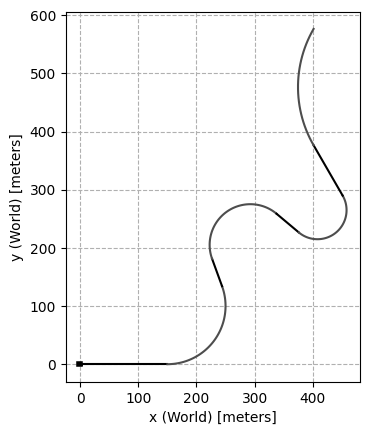

In [13]:
# Define a fixed, difficult road for evaluation
# road_elements_list_difficult = [
#     {"type": "straight", "length": 50.0},
#     {"type": "curved", "curvature": 1/300.0, "angle_in_degrees": 90.0},
#     {"type": "straight", "length": 50.0},
#     {"type": "curved", "curvature": -1/200.0, "angle_in_degrees": 120.0},
#     {"type": "straight", "length": 50.0},
# ]

road_elements_list_difficult = [
    {"type": "straight", "length": 150.0},
    {"type": "curved", "curvature": 1/100.0, "angle_in_degrees": 110.0},
    {"type": "straight", "length": 50.0},
    {"type": "curved", "curvature": -1/70.0, "angle_in_degrees": 150.0},
    {"type": "straight", "length": 50.0},
    {"type": "curved", "curvature": 1/50.0, "angle_in_degrees": 160.0},
    {"type": "straight", "length": 100.0},
    {"type": "curved", "curvature": -1/200.0, "angle_in_degrees": 60.0},

]

# Create the evaluation environment with the fixed difficult road
# eval_env = create_env(road_elements_list_difficult)
eval_env = create_training_env(road_elements_list_difficult)


# Render the road
eval_env.render_matplotlib_init_figure()
eval_env.render_matplotlib_plot_road()
plt.show()

## Model Definition and Training:

流式输出内容被截断，只能显示最后 5000 行内容。
| train/                  |             |
|    approx_kl            | 0.031007564 |
|    clip_fraction        | 0.337       |
|    clip_range           | 0.2         |
|    entropy_loss         | 0.115       |
|    explained_variance   | 0.528       |
|    learning_rate        | 0.0003      |
|    loss                 | 16.9        |
|    n_updates            | 2690        |
|    policy_gradient_loss | 0.0111      |
|    std                  | 0.283       |
|    value_loss           | 29.7        |
-----------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 408        |
|    ep_rew_mean          | 24.7       |
| time/                   |            |
|    fps                  | 339        |
|    iterations           | 21         |
|    time_elapsed         | 126        |
|    total_timesteps      | 555008     |
| train/                  |            |
|    approx_kl   

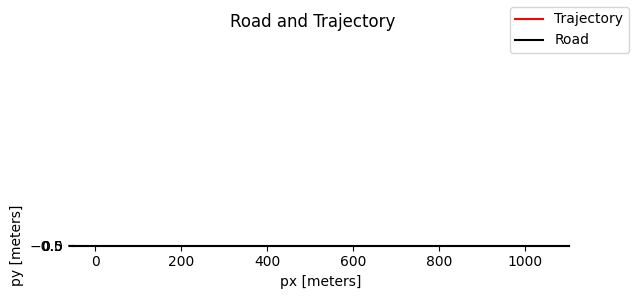

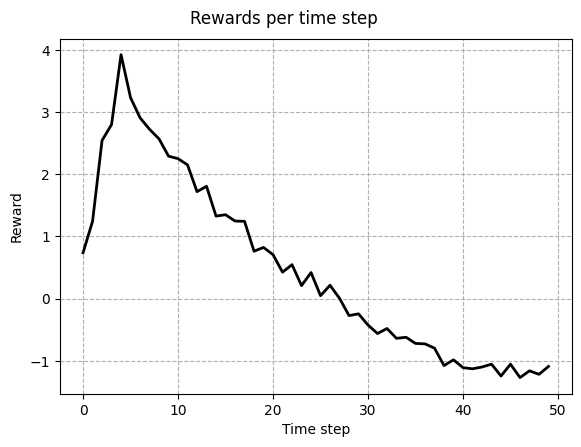

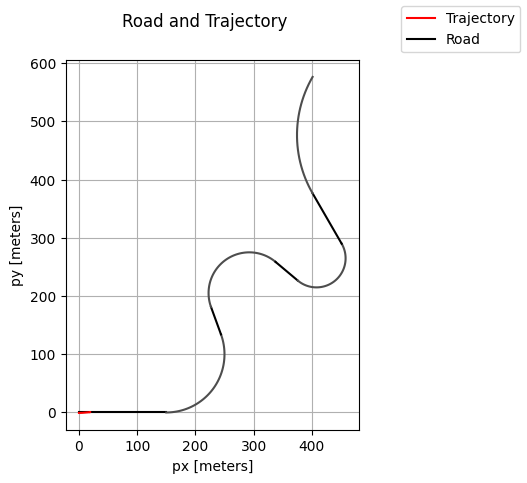

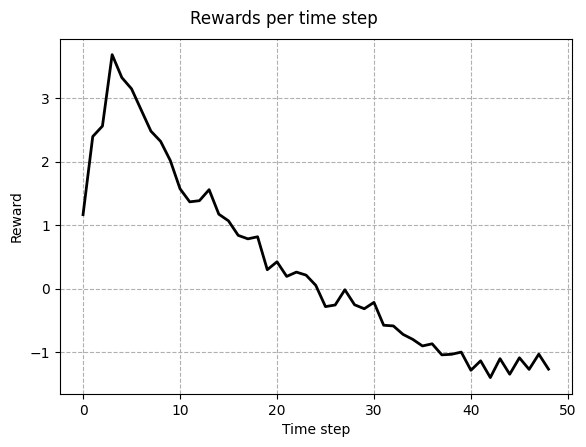

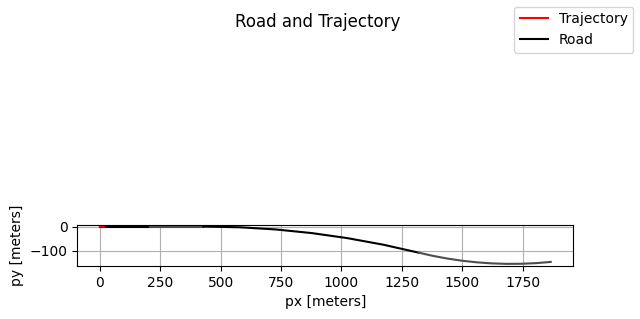

...

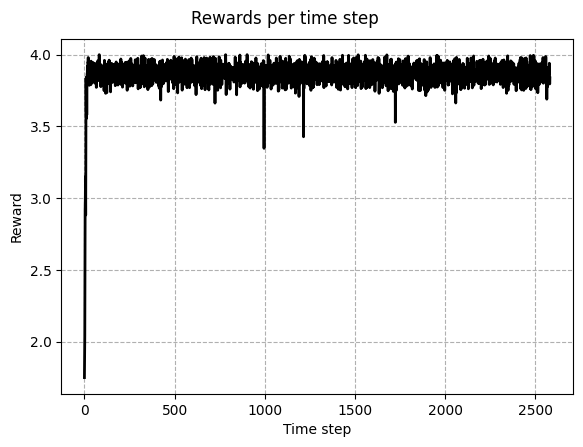

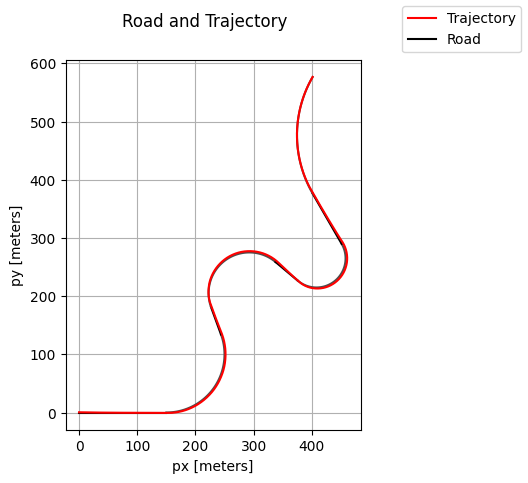

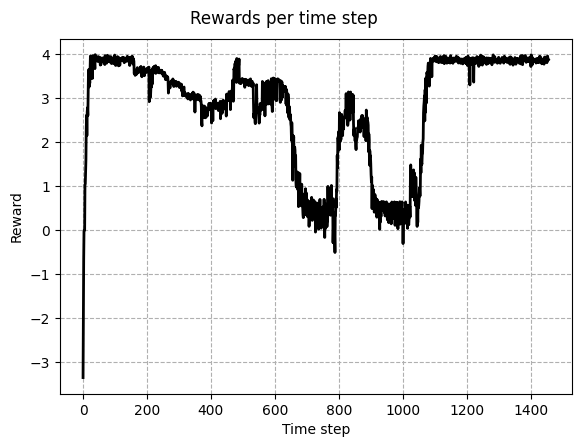

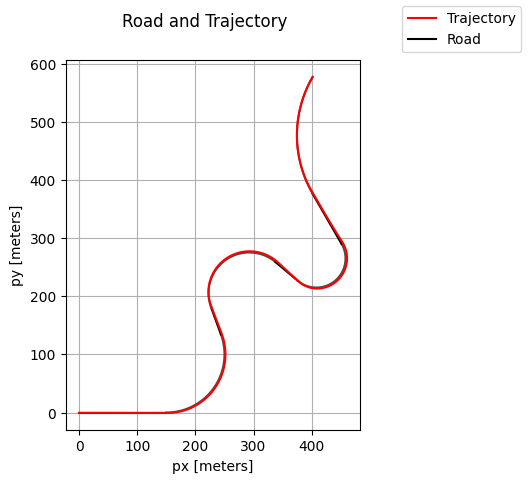

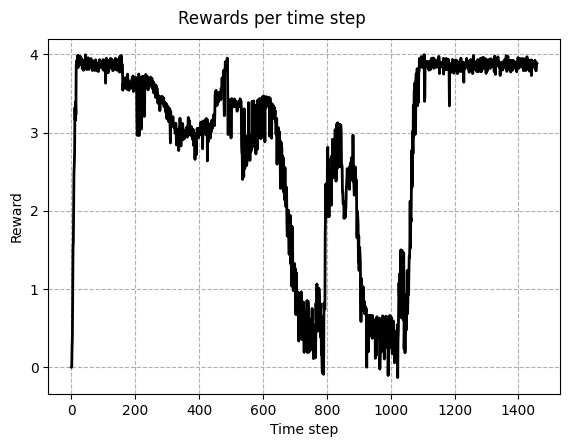

In [15]:
from stable_baselines3 import PPO, SAC, DDPG
# initialise model
model_name = "PPO_progressive_training_updated_reward"
logdir = "logs"
models_dir = f"models/{model_name}"
figs_dir_train = f"models/{model_name}/figs_train"
figs_dir_test = f"models/{model_name}/figs_test"
ensure_dirs([logdir, models_dir, figs_dir_train, figs_dir_test])

initial_env = create_training_env(simple_road_params)

# policy_kwargs = dict(net_arch=[256, 256])
# model = PPO("MultiInputPolicy", initial_env, policy_kwargs=policy_kwargs, verbose=1, tensorboard_log=logdir, batch_size=512)
model = PPO("MultiInputPolicy", initial_env, verbose=1, tensorboard_log=logdir)

# training
total_timesteps = 0
EPOCHS = 20

for stage in training_stages:
    print(f"============================================================ start training: {stage['stage_name']} ============================================================")
    # update environment
    train_env = create_training_env(stage['params'])
    model.set_env(train_env)
    for i in range(1, EPOCHS+1):
        # start training
        model.learn(
            total_timesteps=stage['timesteps'],
            reset_num_timesteps=False,
            tb_log_name=f"{model_name}_{stage['stage_name']}"
        )
        total_timesteps += stage['timesteps']
        # save mnodel
        model.save(f"{models_dir}/{total_timesteps}")

        # evaluate after each stage
        # Evaluate on the most recent training road
        eval_model(train_env, model, figs_dir_train, total_timesteps)
        # Evaluate on evaluation road
        eval_model(eval_env, model, figs_dir_test, total_timesteps)

# final evaluation
print("============================================================ final evaluation ============================================================")
eval_model(eval_env, model, figs_dir_test, total_timesteps)

# Performance Metrics

In [18]:
def compute_performance_metrics_from_time_series(sim_time_series_dict):
    # Compute the statistics of the distance to the line
    abs_dist_to_line_time_series = np.abs(sim_time_series_dict["distance_to_closest_point"])
    speed_time_series = np.abs(sim_time_series_dict["vx"])
    heading_angle_series = np.abs(sim_time_series_dict["heading_angle_relative_to_line"])

    ###############################################
    # Speed Limit Metrics
    # -> Maximum speed above speed limit
    # -> Fraction of time spent above speed limit
    ###############################################
    # determine fraction of time steps spent below speed limit, only include time steps which don't have NaN speed
    max_speed = np.nanmax(speed_time_series)
    max_exceedance_speed_limit = max_speed - SPEED_LIMIT
    num_time_steps_above_speed_limit = np.sum(speed_time_series > SPEED_LIMIT)
    num_steps_non_NaN = np.sum(~np.isnan(sim_time_series_dict['vx']))
    #num_time_steps = len(speed_time_series)-1
    fraction_time_above_speed_limit = num_time_steps_above_speed_limit / num_steps_non_NaN

    ############################################################################################################
    # Smooth Lane Keeping Metrics
    # -> Average distance from line
    # -> Average heading angle relative to line
    # -> Total variation of heading angle (want this to be low for smooth steering)
    # -> Total variation of speed (wnat this to be low for cruise control)
    # Note: total variation is a measure of smoothness, lower value means smoother and less oscillatory steering
    ###########################################################################################################

    # compute average distance from line
    average_distance_from_line = np.nanmean(abs_dist_to_line_time_series)
    # compute average heading angle deviation
    average_heading_angle_deviation_degrees = np.average(heading_angle_series[:num_steps_non_NaN])  * 180.0 / np.pi
    # compute total variation of heading angle (lower tv means smoother and less oscillatory steering)
    total_variation_heading_angle = np.sum(np.abs(np.diff(heading_angle_series[:num_steps_non_NaN])))
    # compute total variation of speed
    total_variation_speed = np.sum(np.abs(np.diff(speed_time_series[:num_steps_non_NaN])))

    ##################################
    #  Faste Travel-time Metrics
    # -> Total travel time
    ##################################
    total_travel_time = num_steps_non_NaN * numerical_integration_parameters["Ts"]


    # Return the results
    return {
        "max_exceedance_speed_limit" : max_exceedance_speed_limit,
        "fraction_time_above_speed_limit" : fraction_time_above_speed_limit,
        "average_dist_from_line"   :  average_distance_from_line,
        "average_heading_angle_deviation_degrees" : average_heading_angle_deviation_degrees,
        "total_variation_heading_angle" : total_variation_heading_angle,
        "total_variation_speed" : total_variation_speed,
        "total_travel_time" : total_travel_time,
    }



Now starting simulation.
Simulation finished




Now starting simulation.
Simulation finished


Performance Metric dictionary:
{'max_exceedance_speed_limit': 1.246247609456379, 'fraction_time_above_speed_limit': 0.005791505791505791, 'average_dist_from_line': 0.3018736, 'average_heading_angle_deviation_degrees': 0.7029424720884965, 'total_variation_heading_angle': 7.153452, 'total_variation_speed': 12.083897, 'total_travel_time': 77.7}
Saved figure: models/compare/eval/ad_cartesian_coords_example.pdf
Saved figure: models/compare/eval/ad_time_series_example.pdf


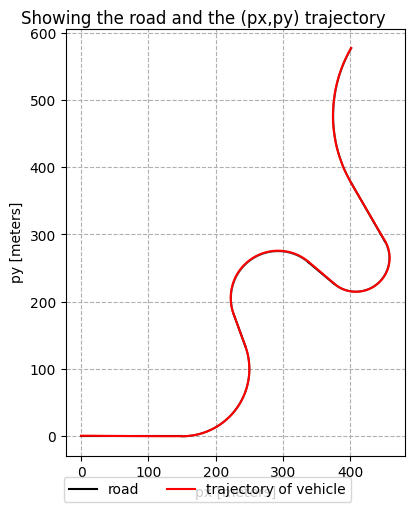

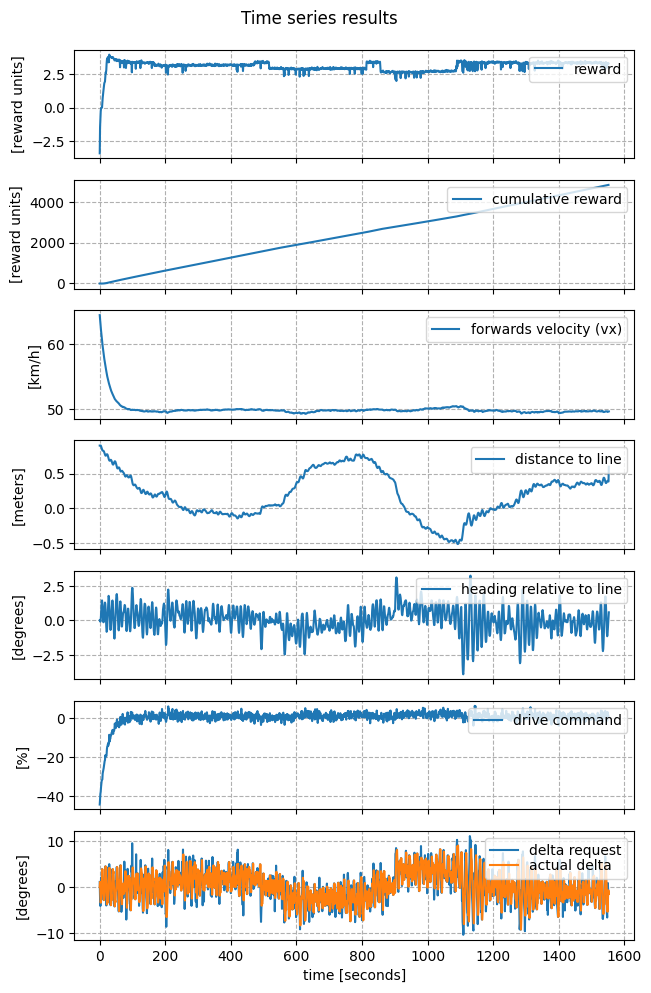

In [40]:
from evaluation.evaluation_for_autonomous_driving import simulate_policy
from evaluation.evaluation_for_autonomous_driving import plot_results_from_time_series_dict
from policies.rl_policy import RLPolicy

rl_policy_1 = RLPolicy(model)

model_path = f"{models_dir}/250000"
model = PPO.load(model_path)

# Put the RL model into a policy class
rl_policy_2 = RLPolicy(model)



# Specify the length of the simulation in time steps
# > If termination or truncation is flagged by the "step" function,
#   Then, the simulation ends.
N_sim = 5000

# Specify the seed for when the simulate function resets the random number generator
sim_seed = 1;

# Call the function for simulating a given RL model
sim_time_series_dict_1 = simulate_policy(eval_env, N_sim, rl_policy_1, seed=sim_seed, verbose=1)
sim_time_series_dict_2 = simulate_policy(eval_env, N_sim, rl_policy_2, seed=sim_seed, verbose=1)

pm_dict_1 = compute_performance_metrics_from_time_series(sim_time_series_dict_1)
pm_dict_2 = compute_performance_metrics_from_time_series(sim_time_series_dict_2)

# Display the performance metric values
print("Performance Metric dictionary:")
print(pm_dict_2)

# Call the plotting function
file_name_suffix = "example"
plot_details_list = plot_results_from_time_series_dict(eval_env, sim_time_series_dict_2, path_for_saving_figures, file_name_suffix, should_plot_reward=True)

In [41]:
def performance_metrics_over_uncertainties(N_sim=5000):
    # Initialise a list for all the performance metrics
    pm_per_sim_list_ppo_1 = []
    pm_per_sim_list_ppo_2 = []
    pm_per_sim_list_ppo_3 = []

    sim_range = range (0,5)
    # specify initial velocity range
    v_init_kmh = np.arange(start=SPEED_LIMIT_KMH-10.0, stop=SPEED_LIMIT_KMH + 10.0, step=5.0)
    # specify delta offset range
    delta_offset_range = np.arange(start=-0.1, stop=0.1, step=0.05)
    # specify list of road variations
    road_variations = []
    for i in range(5):
        road_variations.append(road_elements_list_difficult)

    # Compute the number of simulation that will be performed
    num_sims_total = len(v_init_kmh) * len(delta_offset_range) * len(road_variations) * len(sim_range)

    # Display a progress bar
    print("Now starting " + str(num_sims_total) + " simulations, this may take a while.")
    print("Progress indicator:")
    print("0%        50%       100%")
    print("|----|----|----|----|")
    print("|",end="")

    # Some variables for keeping track of the progress
    progress_inc = 0.05
    next_progress_print = progress_inc
    i_prog = 0


    # Iterate over initial velocity
    for v_init in v_init_kmh:
        # iterate over delta offset
        for delta_offset in delta_offset_range:
            # iterate over road variations
            for road_variation in road_variations:

                # Create an environment with the adjusted parameters
                env_adjusted_1 = create_env(road_variation)
                env_adjusted_2 = create_env(road_variation)
                # env_adjusted_3 = setup_environment(road_variation, observation_parameters_ppo_3, delta_offset_multiplier=delta_offset, v_init=v_init)

                # Initialise a seed for the random number generators
                sim_seed = 0

                # Iterate over 5 simulation
                for i_sim in sim_range:
                    # Increment the seed
                    sim_seed += 1

                    # run simulation with policy 1
                    sim_time_series_dict = simulate_policy(env_adjusted_1, N_sim, rl_policy, seed=sim_seed)
                    # Compute the performance metrics for this simulation
                    pm_dict = compute_performance_metrics_from_time_series(sim_time_series_dict)
                    # Append to the list of all performance metrics
                    pm_per_sim_list_ppo_1.append(pm_dict)

                    # # run simulation with policy 2
                    sim_time_series_dict = simulate_policy(env_adjusted_2, N_sim, rl_policy_2, seed=sim_seed)
                    # Compute the performance metrics for this simulation
                    pm_dict = compute_performance_metrics_from_time_series(sim_time_series_dict)
                    # Append to the list of all performance metrics
                    pm_per_sim_list_ppo_2.append(pm_dict)

                    # # run simulation with policy 3
                    # sim_time_series_dict = simulate_policy(env_adjusted_3, N_sim, rl_policy_3, seed=sim_seed)
                    # # Compute the performance metrics for this simulation
                    # pm_dict = compute_performance_metrics_from_time_series(sim_time_series_dict)
                    # # Append to the list of all performance metrics
                    # pm_per_sim_list_ppo_3.append(pm_dict)

                    # Print progress if necessary
                    i_prog += 1
                    if (i_prog >= (next_progress_print*num_sims_total)):
                        print("-",end="")
                        next_progress_print += progress_inc

    # Print the end of the progress bar
    print("|")

    # Return the list of performance metrics per simulation
    return pm_per_sim_list_ppo_1, pm_per_sim_list_ppo_2

In [42]:
pm_per_sim_list_ppo_1, pm_per_sim_list_ppo_2 = performance_metrics_over_uncertainties(N_sim=5000)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
/content/ai4r-gym/evaluation/evaluation_for_autonomous_driving.py:122: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  reward_sim[this_time_index] = reward


Now starting 400 simulations, this may take a while.
Progress indicator:
0%        50%       100%
|----|----|----|----|
|-------------------|


In [43]:
# save the performance metrics to file
import pickle

with open("models/compare/pm_per_sim_list_ppo_1.pkl", "wb") as f:
    pickle.dump(pm_per_sim_list_ppo_1, f)

with open("models/compare/pm_per_sim_list_ppo_2.pkl", "wb") as f:
    pickle.dump(pm_per_sim_list_ppo_2, f)

# with open("models/compare/pm_per_sim_list_ppo_3.pkl", "wb") as f:
#     pickle.dump(pm_per_sim_list_ppo_3, f)

In [46]:
metrics = ["max_exceedance_speed_limit", "fraction_time_above_speed_limit", "average_dist_from_line", "average_heading_angle_deviation_degrees", "total_variation_heading_angle", "total_variation_speed", "total_travel_time"]

metric_aggregates_ppo_1 = {}
metric_aggregates_ppo_2 = {}
metric_aggregates_ppo_3 = {}

for metric in metrics:
    # compute the average and standard deviation of the performance metrics for the 3 policies
    metric_array_ppo_1 = np.array([d[metric] for d in pm_per_sim_list_ppo_1])
    metric_array_ppo_2 = np.array([d[metric] for d in pm_per_sim_list_ppo_2])
    # metric_array_ppo_3 = np.array([d[metric] for d in pm_per_sim_list_ppo_3])
    average_metric_ppo_1 = np.average(metric_array_ppo_1)
    average_metric_ppo_2 = np.average(metric_array_ppo_2)
    # average_metric_ppo_3 = np.average(metric_array_ppo_3)
    std_metric_ppo_1 = np.std(metric_array_ppo_1)
    std_metric_ppo_2 = np.std(metric_array_ppo_2)
    # std_metric_ppo_3 = np.std(metric_array_ppo_3)

    metric_aggregates_ppo_1[metric] = {"average": average_metric_ppo_1, "std": std_metric_ppo_1}
    metric_aggregates_ppo_2[metric] = {"average": average_metric_ppo_2, "std": std_metric_ppo_2}
    # metric_aggregates_ppo_3[metric] = {"average": average_metric_ppo_3, "std": std_metric_ppo_3}

# print the results in a table with 3 columns for the 3 policies
print("Performance Metric Aggregates:")
print("Metric".ljust(50) + "PPO 1000000".ljust(20) + "PPO 250000".ljust(20))
print("-"*110)
for metric in metrics:
    print(metric.ljust(50) + "{:.2f} +/- {:.2f}".format(metric_aggregates_ppo_1[metric]["average"], metric_aggregates_ppo_1[metric]["std"]).ljust(20) + "{:.2f} +/- {:.2f}".format(metric_aggregates_ppo_2[metric]["average"], metric_aggregates_ppo_2[metric]["std"]).ljust(20))


Performance Metric Aggregates:
Metric                                            PPO 1000000         PPO 250000          
--------------------------------------------------------------------------------------------------------------
max_exceedance_speed_limit                        -0.28 +/- 0.92      -0.28 +/- 0.92      
fraction_time_above_speed_limit                   0.00 +/- 0.00       0.00 +/- 0.00       
average_dist_from_line                            1.16 +/- 0.01       0.32 +/- 0.03       
average_heading_angle_deviation_degrees           0.86 +/- 0.03       0.89 +/- 0.12       
total_variation_heading_angle                     1.64 +/- 0.04       8.75 +/- 0.97       
total_variation_speed                             15.36 +/- 0.85      11.42 +/- 1.00      
total_travel_time                                 72.98 +/- 0.04      77.80 +/- 0.10      


## Evaluating the RL Policy:

### Load an RL model from the training loop:

In [ ]:
model_name = "PPO_training"
model_idx = 950000

path_for_saving_figures = f"models/{model_name}/eval"
ensure_dir(path_for_saving_figures)

### Put the RL model into a policy class with a 'standardize' interface

In [ ]:
from policies.rl_policy import RLPolicy

# Put the RL model into a policy class
rl_policy = RLPolicy(model)

### Perform One simulation of the policy, plot the time series results:



Now starting simulation.


/content/ai4r-gym/evaluation/evaluation_for_autonomous_driving.py:122: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  reward_sim[this_time_index] = reward


Simulation finished


Saved figure: models/PPO_training/eval/ad_cartesian_coords_example.pdf
Saved figure: models/PPO_training/eval/ad_time_series_example.pdf


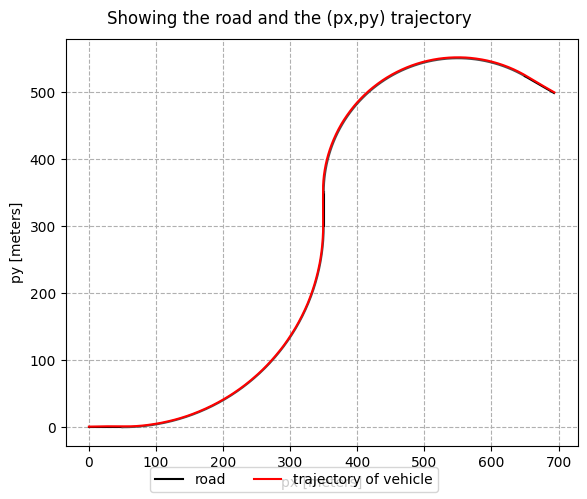

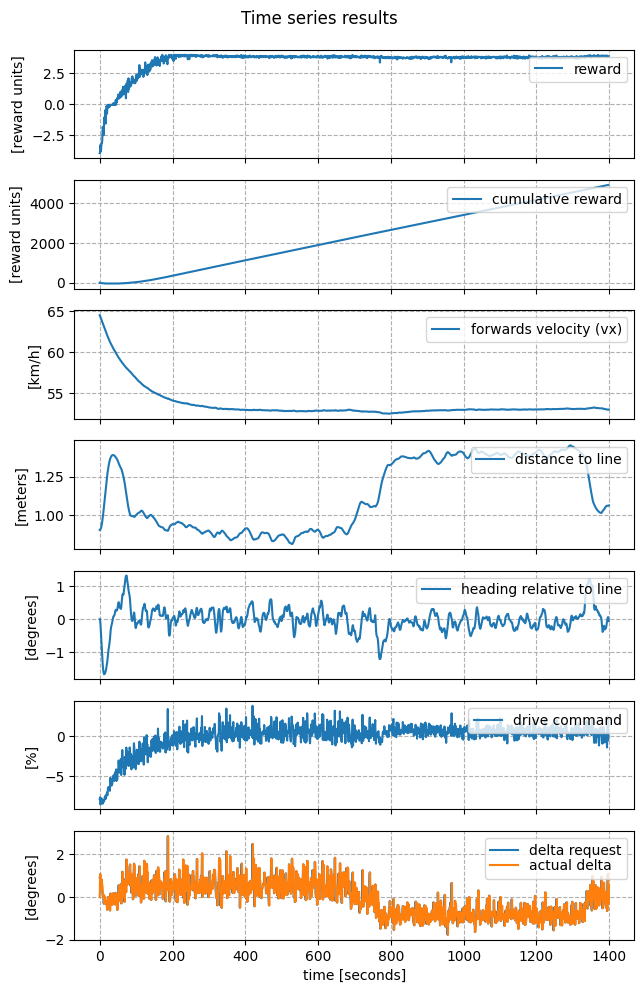

In [ ]:
# Import the function for simulating the autonomous driving environment
from evaluation.evaluation_for_autonomous_driving import simulate_policy
from evaluation.evaluation_for_autonomous_driving import plot_results_from_time_series_dict

# Specify the length of the simulation in time steps
# > If termination or truncation is flagged by the "step" function,
#   Then, the simulation ends.
N_sim = 5000

# Specify the seed for when the simulate function resets the random number generator
sim_seed = 1;

# Call the function for simulating a given RL model
sim_time_series_dict = simulate_policy(eval_env, N_sim, rl_policy, seed=sim_seed, verbose=1)

# Call the plotting function
file_name_suffix = "example"
plot_details_list = plot_results_from_time_series_dict(eval_env, sim_time_series_dict, path_for_saving_figures, file_name_suffix, should_plot_reward=True)

### Animate the time series results:

In [ ]:
def animate_from_sim_time_series_dict(sim_time_series_dict, Ts, path_for_saving_figures):
    # Extract the necessary trajectory information from the "sim_time_series_dict"
    px_traj    = sim_time_series_dict["px"]
    py_traj    = sim_time_series_dict["py"]
    theta_traj = sim_time_series_dict["theta"]
    delta_traj = sim_time_series_dict["delta"]
    # Call the environments function to create the simulation
    ani = eval_env.unwrapped.render_matplotlib_animation_of_trajectory(px_traj, py_traj, theta_traj, delta_traj, Ts, traj_increment=3)
    # Save the animation
    ani.save(f"{path_for_saving_figures}/trajectory_animation.gif")
    print(f'Saved animation at {path_for_saving_figures}/trajectory_animation.gif')
    # Return the animation object
    return ani

Now creating the animation, this may take some time.
Saved animation at models/PPO_training/eval/trajectory_animation.gif


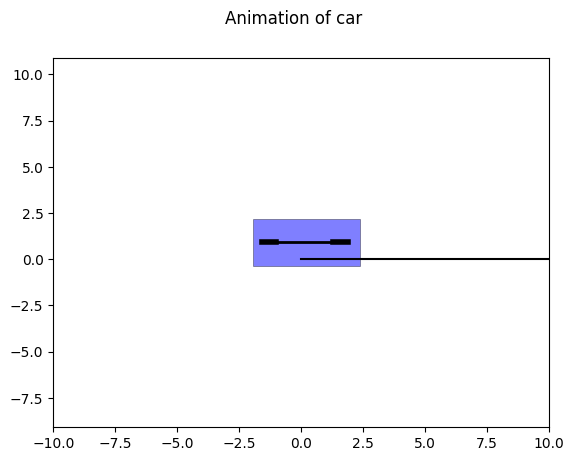

In [ ]:
# Call the animation functoin
ani = animate_from_sim_time_series_dict(sim_time_series_dict, numerical_integration_parameters["Ts"], path_for_saving_figures)
# Display the animation
from IPython.display import HTML
HTML(ani.to_jshtml())

## Performance Metrics:

In [ ]:
sim_time_series_dict

### Define a performance Metrics Function per simulation time series:

In [ ]:
def compute_performance_metrics_from_time_series(sim_time_series_dict):
    # Compute the statistics of the distance to the line
    # > Note that this is signed value, hence need to take absolute value of the data.
    abs_dist_to_line_time_series = np.abs(sim_time_series_dict["distance_to_closest_point"])
    avg_dist  = np.nanmean(abs_dist_to_line_time_series)
    std_dist  = np.nanstd(abs_dist_to_line_time_series)
    sum_dist = np.nansum(abs_dist_to_line_time_series)
    max_dist  = np.nanmax(abs_dist_to_line_time_series)

    # Compute the statistics of the speed in the forward direction (i.e., the body-frame x-axis direction)
    speed_time_series = np.abs(sim_time_series_dict["vx"])
    avg_speed = np.nanmean(speed_time_series)
    std_speed = np.nanstd(speed_time_series)
    max_speed = np.nanmax(speed_time_series)
    min_speed = np.nanmin(speed_time_series)

    # Return the results
    return {
        "avg_dist"   :  avg_dist,
        "std_dist"   :  std_dist,
        "max_dist"   :  max_dist,
        "avg_speed"  :  avg_speed * 3.6,
        "std_speed"  :  std_speed * 3.6,
        "max_speed"  :  max_speed * 3.6,
        "min_speed"  :  min_speed * 3.6,
    }


### Run the Performance Metric Function for one simulation:

In [ ]:
# Simulate with the same seed as above to check that it gets the results consistent
sim_seed = 1;
sim_time_series_dict = simulate_policy(eval_env, N_sim, rl_policy, seed=sim_seed, verbose=1)

# Call the function for computing the performance metrics
pm_dict = compute_performance_metrics_from_time_series(sim_time_series_dict)

# Display the performance metric values
print("Performance Metric dictionary:")
print(pm_dict)



Now starting simulation.


/content/ai4r-gym/evaluation/evaluation_for_autonomous_driving.py:122: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  reward_sim[this_time_index] = reward


Simulation finished


Performance Metric dictionary:
{'avg_dist': 1.1409203, 'std_dist': 0.22853665, 'max_dist': 1.4486084, 'avg_speed': 53.64391250610352, 'std_speed': 1.95065495967865, 'max_speed': 64.48649139404297, 'min_speed': 52.441280364990234}


**NOTE:**
> Please refer to the notebook `autonomous_driving_gym_v2024_08_24.ipynb` for more details on evaluation and performance metrics.